In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip uninstall -y pandas-profiling
!pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.0/390.0 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 21.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 45.8 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=97e7980a67e98b6cb04c159972ba6115adf152eaafa7143be60618d4385585be
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, f1_score, roc_auc_score
from pandas_profiling import ProfileReport
from scipy import stats
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

<ipython-input-3-7394e8ca771a>:11: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [ ]:
# df = pd.read_csv('/content/drive/MyDrive/Machine Learning Projects/Machine Learning Regression Project/startup data.csv')
df = pd.read_csv('/content/drive/MyDrive/startup data.csv')

In [ ]:
df.shape

(923, 49)

In [ ]:
df.sample(10)

,Unnamed: 0,state_code,latitude,longitude,zip_code,id,city,Unnamed: 6,name,labels,...,object_id,has_VC,has_angel,has_roundA,has_roundB,has_roundC,has_roundD,avg_participants,is_top500,status
46,747,NY,40.730646,-73.986614,100011,c:43188,New York,New York NY 100011,Go Try It On,1,...,c:43188,0,1,1,0,0,0,2.0,1,acquired
185,1090,CA,37.779281,-122.419236,94108,c:81886,San Francisco,San Francisco CA 94108,skyrockit,0,...,c:81886,1,0,0,0,0,0,1.0,1,closed
431,886,CA,34.066697,-118.383367,90211,c:53304,Beverly Hills,Beverly Hills CA 90211,GeekStatus,0,...,c:53304,0,1,0,0,0,0,1.0,0,closed
68,452,CA,37.547630,-122.307887,94403-1855,c:26128,San Mateo,NaN,Sana Security,1,...,c:26128,0,0,0,0,0,0,2.0,1,acquired
618,581,WA,45.630695,-122.674456,98665,c:32144,Vancouver,Vancouver WA 98665,Idooble,0,...,c:32144,0,1,0,0,0,0,1.0,0,closed
95,895,CA,37.406914,-122.090370,94043,c:54066,Mountain View,Mountain View CA 94043,Blue Vector Systems,0,...,c:54066,0,0,0,1,0,0,3.0,1,closed
646,1000,CA,37.781927,-122.393239,94107,c:6562,San Francisco,NaN,Socialcast,1,...,c:6562,0,1,1,1,0,0,1.5,1,acquired
370,78,NY,40.751661,-73.984333,10011,c:130,New York,NaN,KickApps,1,...,c:130,0,0,1,1,1,0,3.0,1,acquired
406,694,NY,40.730646,-73.986614,10010,c:39801,New York,New York NY 10010,Storm Exchange,0,...,c:39801,1,0,1,0,0,0,2.0,1,closed
53,364,MA,42.375640,-71.235800,2451,c:22027,Waltham,Waltham MA 2451,Colubris Networks,1,...,c:22027,1,0,0,0,0,1,5.0,1,acquired


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 923 entries, 0 to 922
Data columns (total 49 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                923 non-null    int64  
 1   state_code                923 non-null    object 
 2   latitude                  923 non-null    float64
 3   longitude                 923 non-null    float64
 4   zip_code                  923 non-null    object 
 5   id                        923 non-null    object 
 6   city                      923 non-null    object 
 7   Unnamed: 6                430 non-null    object 
 8   name                      923 non-null    object 
 9   labels                    923 non-null    int64  
 10  founded_at                923 non-null    object 
 11  closed_at                 335 non-null    object 
 12  first_funding_at          923 non-null    object 
 13  last_funding_at           923 non-null    object 
 14  age_first_

In [ ]:
df.describe()

,Unnamed: 0,latitude,longitude,labels,age_first_funding_year,age_last_funding_year,age_first_milestone_year,age_last_milestone_year,relationships,funding_rounds,...,is_consulting,is_othercategory,has_VC,has_angel,has_roundA,has_roundB,has_roundC,has_roundD,avg_participants,is_top500
count,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,771.000000,771.000000,923.000000,923.000000,...,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000
mean,572.297941,38.517442,-103.539212,0.646804,2.235630,3.931456,3.055353,4.754423,7.710726,2.310943,...,0.003250,0.322860,0.326111,0.254605,0.508126,0.392199,0.232936,0.099675,2.838586,0.809317
std,333.585431,3.741497,22.394167,0.478222,2.510449,2.967910,2.977057,3.212107,7.265776,1.390922,...,0.056949,0.467823,0.469042,0.435875,0.500205,0.488505,0.422931,0.299729,1.874601,0.393052
min,1.000000,25.752358,-122.756956,0.000000,-9.046600,-9.046600,-14.169900,-7.005500,0.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,283.500000,37.388869,-122.198732,0.000000,0.576700,1.669850,1.000000,2.411000,3.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.500000,1.000000
50%,577.000000,37.779281,-118.374037,1.000000,1.446600,3.528800,2.520500,4.476700,5.000000,2.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,2.500000,1.000000
75%,866.500000,40.730646,-77.214731,1.000000,3.575350,5.560250,4.686300,6.753400,10.000000,3.000000,...,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,3.800000,1.000000
max,1153.000000,59.335232,18.057121,1.000000,21.895900,21.895900,24.684900,24.684900,63.000000,10.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,16.000000,1.000000


In [ ]:
profile = ProfileReport(df, title="Profiling Report for Startup Success", html={'style':{'full_width':True}}, sort='Ascending')
profile.to_file(output_file='Startuo_Success.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile

In [ ]:
df.isnull().sum()

,0
Unnamed: 0,0
state_code,0
latitude,0
longitude,0
zip_code,0
id,0
city,0
Unnamed: 6,493
name,0
labels,0


In [ ]:
# Drop unnecessary columns
df.drop(['Unnamed: 6', 'state_code.1'], axis=1, inplace=True)

In [ ]:
# Fill closed_at with today's date if still operational
df['closed_at'].fillna(pd.to_datetime('today'), inplace=True)

<ipython-input-15-82dfc747190d>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['closed_at'].fillna(pd.to_datetime('today'), inplace=True)


In [ ]:
# Fill milestone-related columns with 0
df['age_first_milestone_year'].fillna(0, inplace=True)
df['age_last_milestone_year'].fillna(0, inplace=True)

<ipython-input-16-e5d91b561932>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['age_first_milestone_year'].fillna(0, inplace=True)
<ipython-input-16-e5d91b561932>:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', tr

In [ ]:
# Fill categorical columns with mode
for col in ['category_code', 'state_code']:
    df[col].fillna(df[col].mode()[0], inplace=True)

<ipython-input-17-5be906f7e7e8>:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mode()[0], inplace=True)


In [ ]:
# Check if all missing values have been handled
print(df.isnull().sum())

Unnamed: 0                  0
state_code                  0
latitude                    0
longitude                   0
zip_code                    0
id                          0
city                        0
name                        0
labels                      0
founded_at                  0
closed_at                   0
first_funding_at            0
last_funding_at             0
age_first_funding_year      0
age_last_funding_year       0
age_first_milestone_year    0
age_last_milestone_year     0
relationships               0
funding_rounds              0
funding_total_usd           0
milestones                  0
is_CA                       0
is_NY                       0
is_MA                       0
is_TX                       0
is_otherstate               0
category_code               0
is_software                 0
is_web                      0
is_mobile                   0
is_enterprise               0
is_advertising              0
is_gamesvideo               0
is_ecommer

<ipython-input-19-9c9bc708c350>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='labels', data=df, palette='viridis')


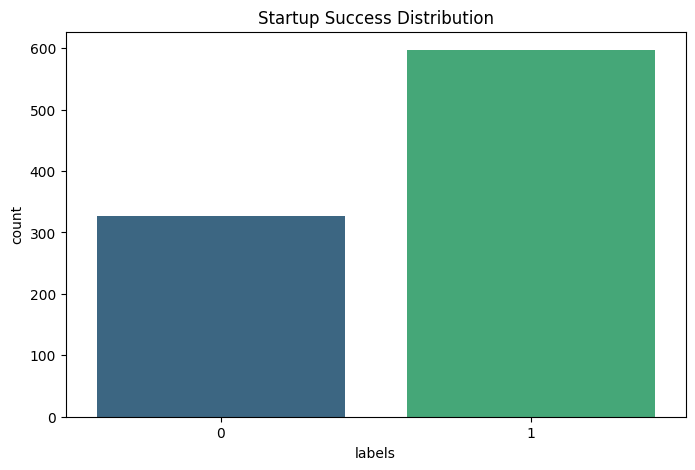

In [ ]:
# Target Variable Distribution ----
# Analyze distribution of the target variable 'labels'
plt.figure(figsize=(8, 5))
sns.countplot(x='labels', data=df, palette='viridis')
plt.title("Startup Success Distribution")
plt.show()

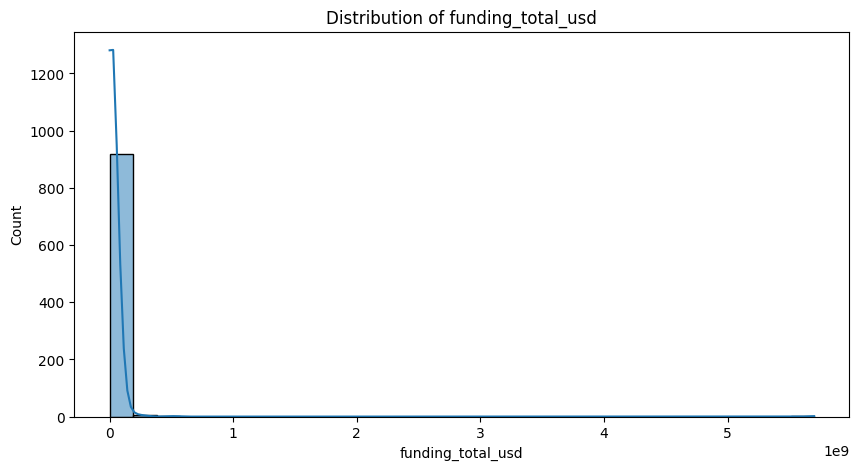

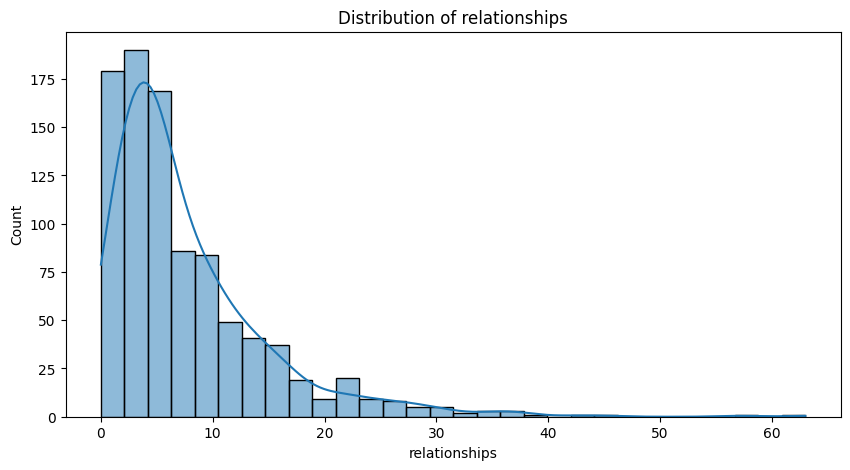

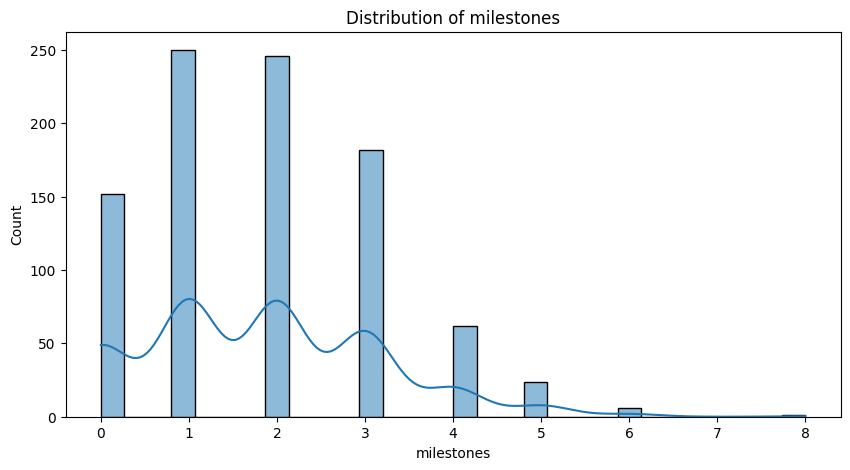

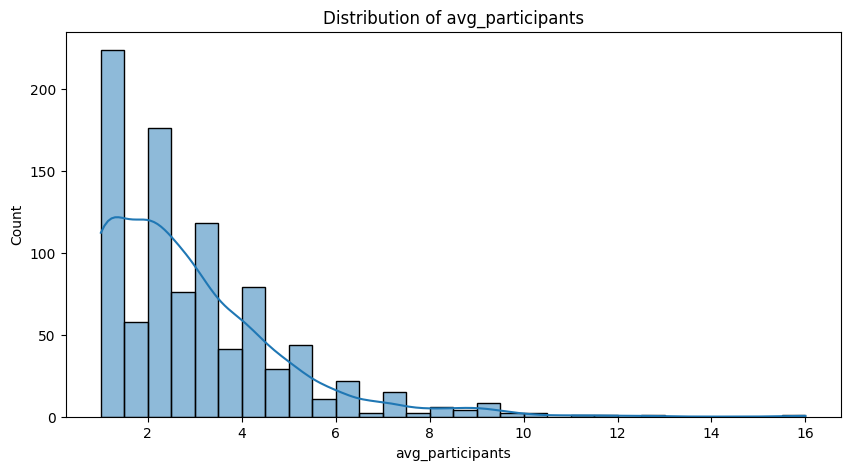

In [ ]:
# Numerical Feature Distributions ----
# Plot distributions for numerical features
numerical_features = ['funding_total_usd', 'relationships', 'milestones', 'avg_participants']
for feature in numerical_features:
    plt.figure(figsize=(10, 5))
    sns.histplot(df[feature], kde=True, bins=30)
    plt.title(f"Distribution of {feature}")
    plt.show()

<ipython-input-21-c219cd603cd0>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='category_code', data=df, order=df['category_code'].value_counts().index, palette="plasma")


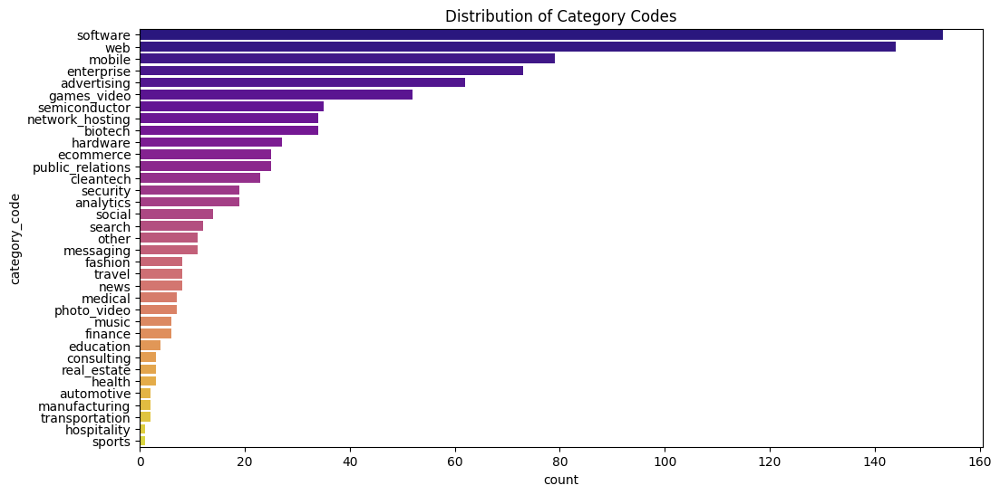

In [ ]:
# Categorical Feature Analysis ----
# Analyze 'category_code' distribution
plt.figure(figsize=(12, 6))
sns.countplot(y='category_code', data=df, order=df['category_code'].value_counts().index, palette="plasma")
plt.title("Distribution of Category Codes")
plt.show()

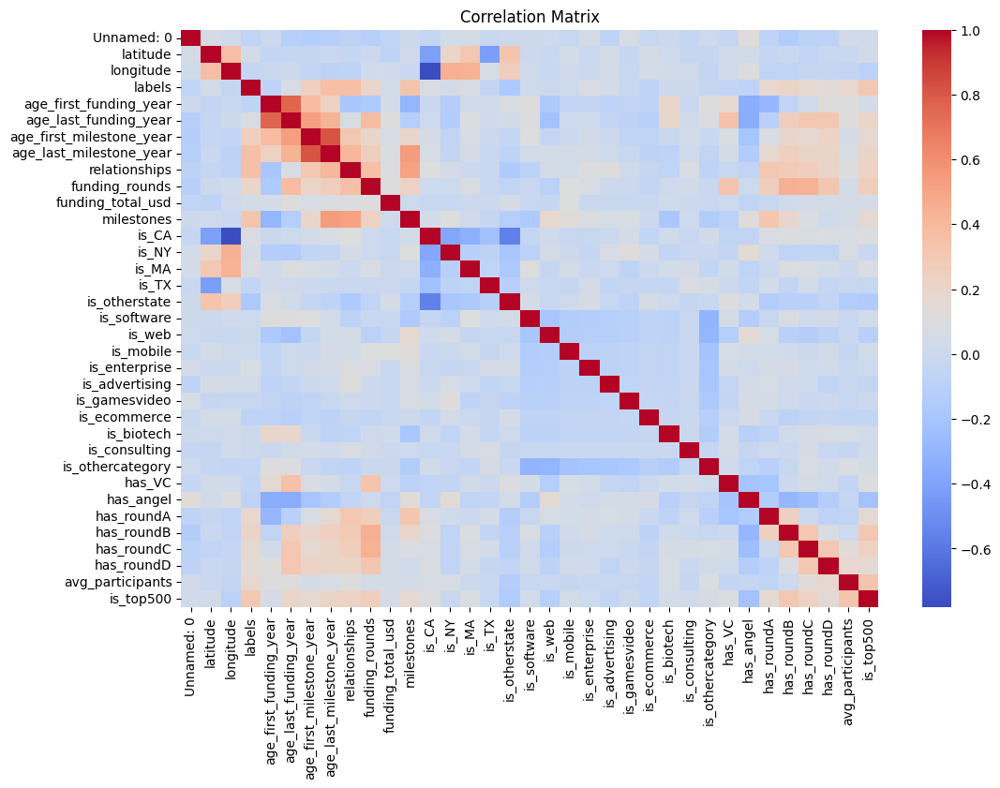

In [ ]:
# Correlation Analysis
# Correlation matrix for numerical features
numeric_df = df.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(12, 8))
correlation = numeric_df.corr()
sns.heatmap(correlation, annot=False, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

In [ ]:
# Display features with high correlation with the target
correlations_with_target = correlation['labels'].sort_values(ascending=False)
print("\nFeatures Highly Correlated with Success:")
print(correlations_with_target[1:6])  # Top 5 features correlated with 'labels'


Features Highly Correlated with Success:
relationships               0.360434
age_last_milestone_year     0.358600
milestones                  0.328260
is_top500                   0.310652
age_first_milestone_year    0.250163
Name: labels, dtype: float64


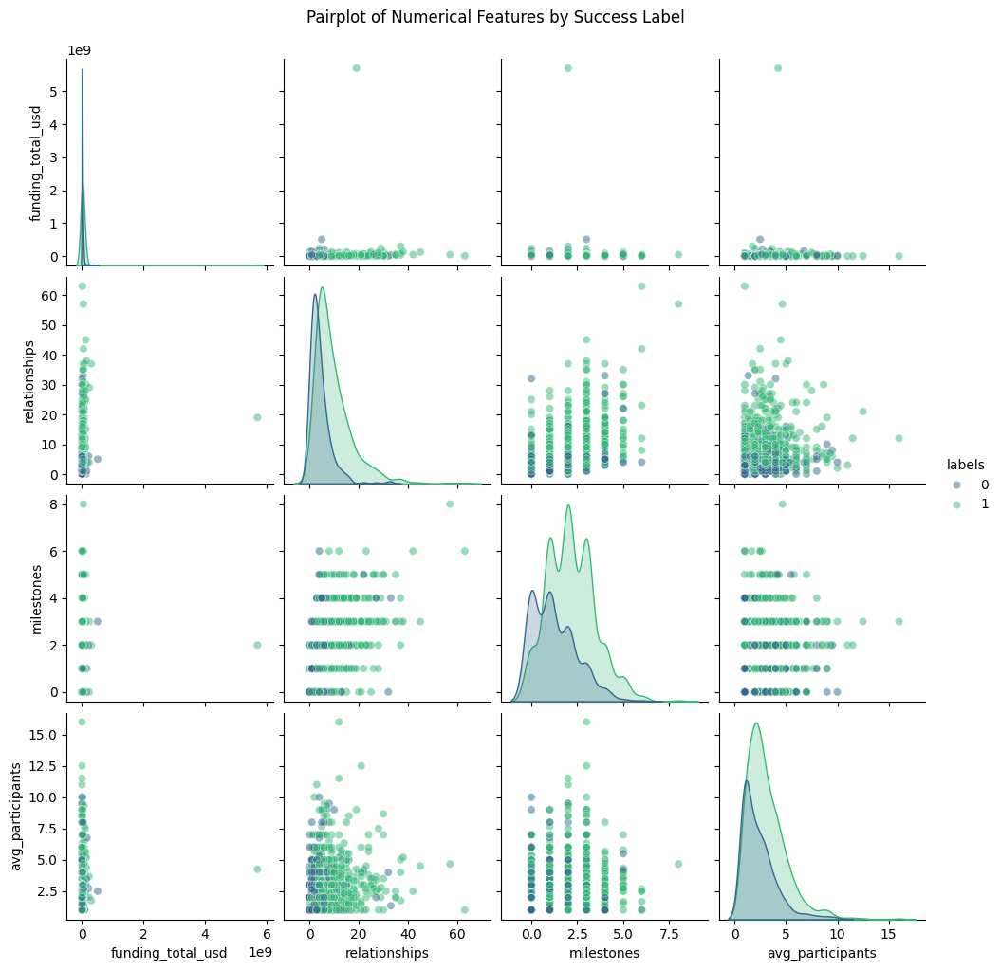

In [ ]:
# Pairplot Analysis ----
# Pairplot to explore relationships between features for successful vs. non-successful startups
sns.pairplot(df, vars=numerical_features, hue='labels', palette="viridis", plot_kws={'alpha':0.5})
plt.suptitle("Pairplot of Numerical Features by Success Label", y=1.02)
plt.show()

<ipython-input-25-3150691959ea>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x='labels', y=feature, palette='viridis')


<Figure size 1500x1000 with 0 Axes>

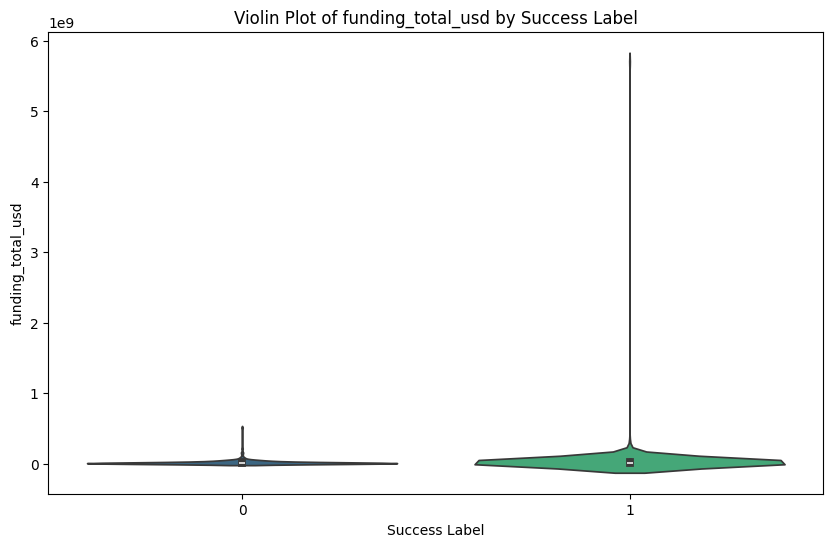

<ipython-input-25-3150691959ea>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x='labels', y=feature, palette='viridis')


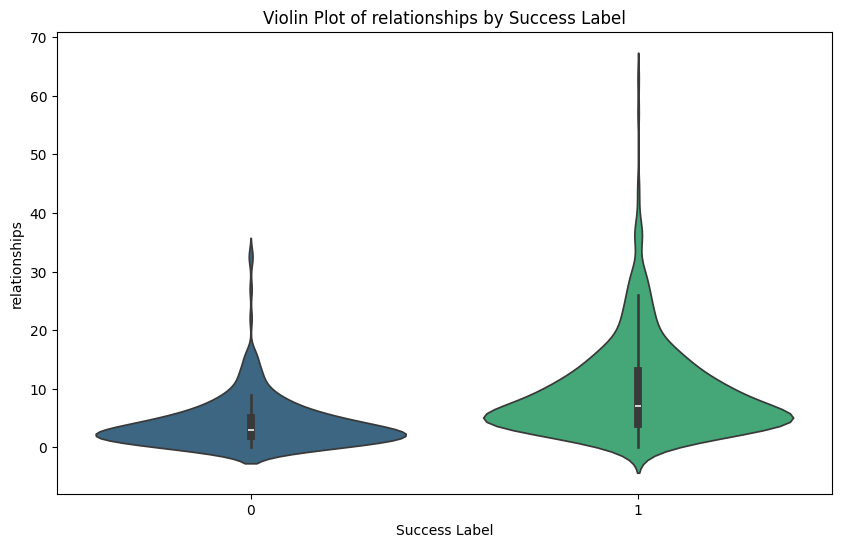

<ipython-input-25-3150691959ea>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x='labels', y=feature, palette='viridis')


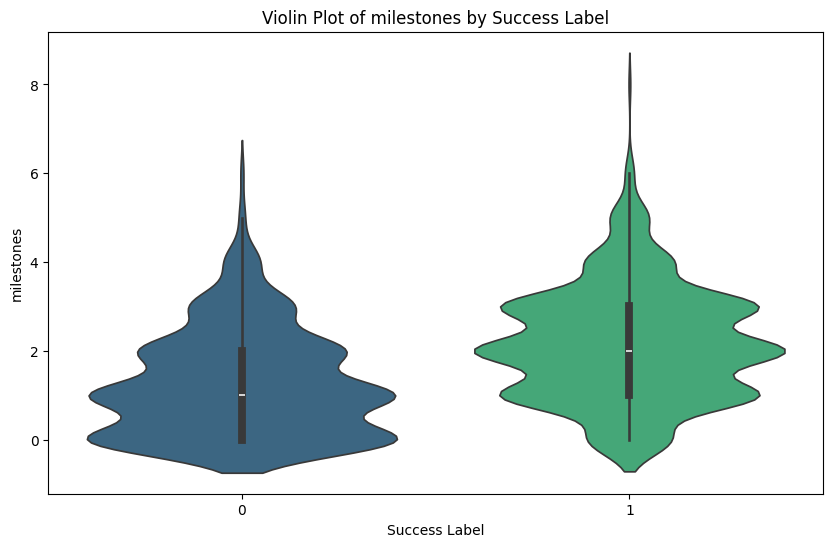

<ipython-input-25-3150691959ea>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x='labels', y=feature, palette='viridis')


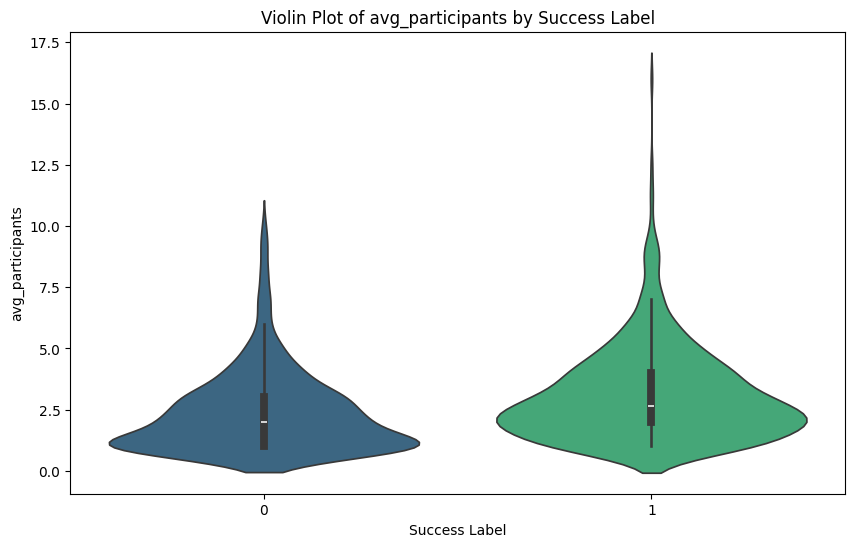

In [ ]:
# List of numerical features to plot
numerical_features = ['funding_total_usd', 'relationships', 'milestones', 'avg_participants']

# Plot violin plots for each numerical feature against 'labels'
plt.figure(figsize=(15, 10))
for i, feature in enumerate(numerical_features, 1):
    plt.figure(figsize=(10, 6))
    sns.violinplot(data=df, x='labels', y=feature, palette='viridis')
    plt.title(f'Violin Plot of {feature} by Success Label')
    plt.xlabel("Success Label")
    plt.ylabel(feature)
    plt.show()

<ipython-input-26-d95051412593>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y=feature, palette='coolwarm')


<Figure size 1500x1000 with 0 Axes>

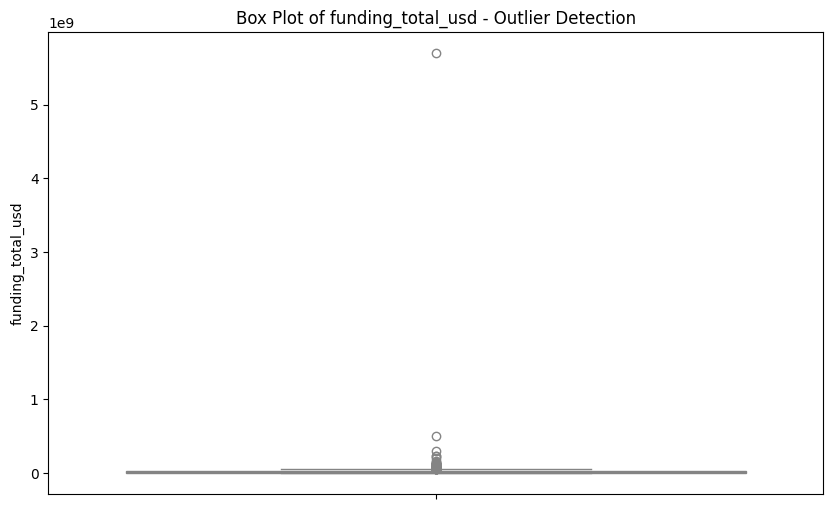

<ipython-input-26-d95051412593>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y=feature, palette='coolwarm')


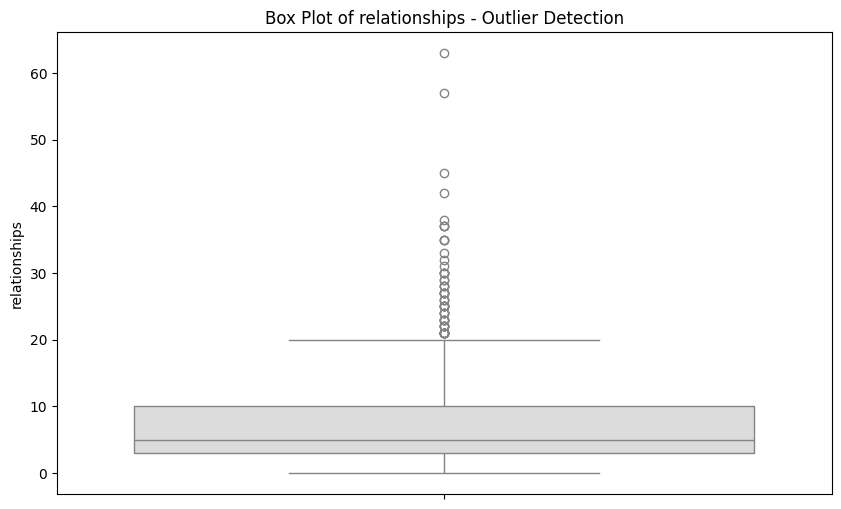

<ipython-input-26-d95051412593>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y=feature, palette='coolwarm')


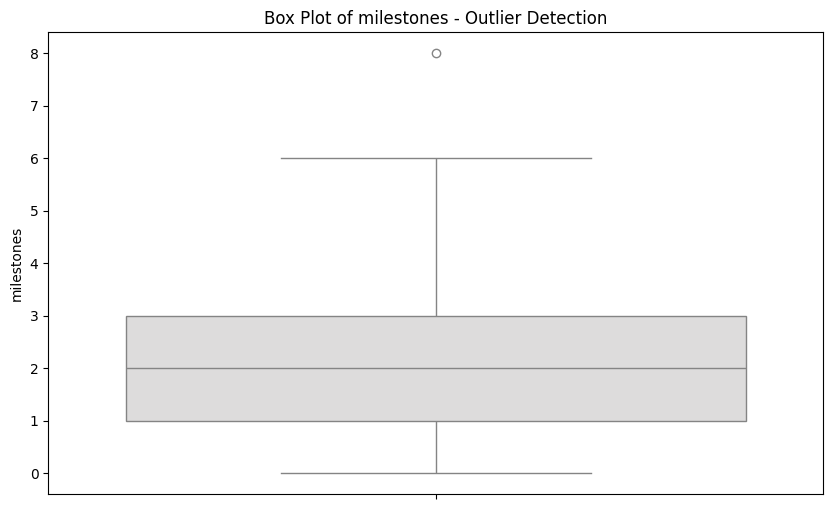

<ipython-input-26-d95051412593>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y=feature, palette='coolwarm')


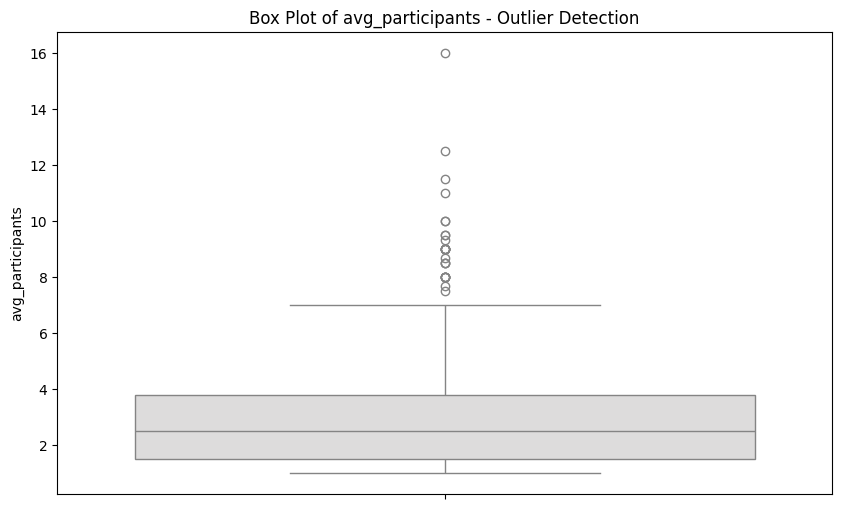

In [ ]:
# List of numerical features to plot
numerical_features = ['funding_total_usd', 'relationships', 'milestones', 'avg_participants']

# Plot box plots for each numerical feature to detect outliers
plt.figure(figsize=(15, 10))
for i, feature in enumerate(numerical_features, 1):
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df, y=feature, palette='coolwarm')
    plt.title(f'Box Plot of {feature} - Outlier Detection')
    plt.ylabel(feature)
    plt.show()

In [ ]:
# Calculate Z-scores
z_scores = np.abs(stats.zscore(df[numerical_features]))

# Define a threshold for identifying outliers
threshold = 3

# Identify outliers
outliers = np.where(z_scores > threshold)
outlier_rows = df.iloc[outliers[0]]

print("Outlier Rows based on Z-score:")
print(outlier_rows)

Outlier Rows based on Z-score:
     Unnamed: 0 state_code   latitude   longitude zip_code        id  \
28          642         TX  30.265344  -97.743586    78701   c:36920   
48         1010         CA  37.779281 -122.419236    94607   c:68157   
54           31         CA  37.787084 -122.403805    94103     c:109   
88          491         CA  37.388869 -122.072353    94041  c:280611   
105         339         VA  38.030823  -78.481580    22902     c:202   
155         937         CA  37.782453 -122.387949    94107   c:58512   
170          30         NY  40.743808  -73.983626    10016    c:1088   
200         196         CA  34.019657 -118.487549    90405  c:162116   
205         363         CA  37.766909 -122.406676    94103     c:220   
212         671         CA  37.779281 -122.419236    94110   c:38339   
216         587         CA  33.972790 -118.427578    90094    c:3288   
230         837         TX  33.068275  -96.711101    75023   c:48640   
275         672         NC  35.98

In [ ]:
#importing models
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import Lasso, Ridge

In [ ]:
# Assuming 'status' is the target variable and rest are features
X = df.drop(['status'], axis=1)  # Features
y = df['status']  # Target variable (binary classification)

In [ ]:
def prepare_data(df):
    columns_to_drop = ['Unnamed: 0', 'id', 'object_id', 'name', 'funding_total_usd',
                      'founded_at', 'closed_at', 'first_funding_at', 'last_funding_at']

    X = df.drop(columns_to_drop, axis=1)
    y = np.log1p(df['funding_total_usd'])

    # Convert categorical variables
    categorical_cols = X.select_dtypes(include=['object']).columns
    X = pd.get_dummies(X, columns=categorical_cols)

    # Split and scale
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    return X_train_scaled, X_test_scaled, y_train, y_test

Linear Regression Performance Metrics:
R² Score: -9322140586407801734901530624.0000
MSE: 26424312364120563255798136832.0000
RMSE: 162555567004395.6562
MAE: 61725191600563.1562


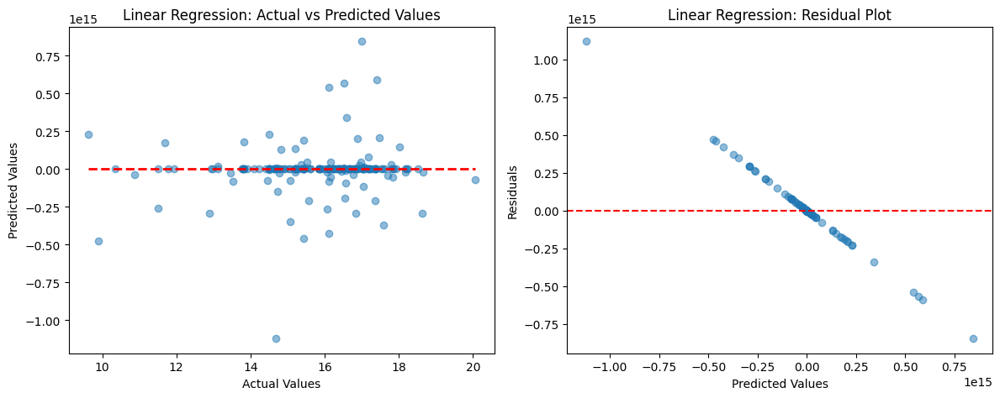

In [ ]:
from sklearn.linear_model import LinearRegression


# Update train_linear_regression function
def train_linear_regression(X_train, X_test, y_train, y_test):
    # Initialize and train model
    linear_model = LinearRegression()
    linear_model.fit(X_train, y_train)

    # Make predictions
    y_pred = linear_model.predict(X_test)

    # Calculate metrics
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)

    print("Linear Regression Performance Metrics:")
    print(f"R² Score: {r2:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE: {mae:.4f}")

    # Visualization
    plt.figure(figsize=(12, 5))

    # Actual vs Predicted
    plt.subplot(1, 2, 1)
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title('Linear Regression: Actual vs Predicted Values')

    # Residuals
    plt.subplot(1, 2, 2)
    residuals = y_test - y_pred
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('Linear Regression: Residual Plot')
    plt.axhline(y=0, color='r', linestyle='--')

    plt.tight_layout()
    plt.show()

    return linear_model, y_pred

# Run Linear Regression analysis
X_train_scaled, X_test_scaled, y_train, y_test = prepare_data(df)
linear_model, linear_predictions = train_linear_regression(X_train_scaled, X_test_scaled, y_train, y_test)


KNN Regressor Performance Metrics:
R² Score: 0.1432
MSE: 2.4285
RMSE: 1.5584
MAE: 1.1527


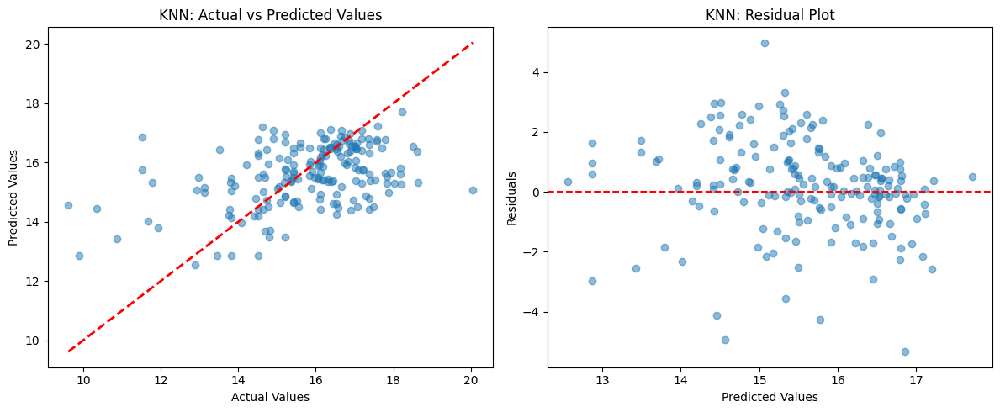

In [ ]:

# Update train_knn function
def train_knn(X_train, X_test, y_train, y_test):
    # Initialize and train model
    knn = KNeighborsRegressor(n_neighbors=5)
    knn.fit(X_train, y_train)

    # Make predictions
    y_pred = knn.predict(X_test)

    # Calculate metrics
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)

    print("KNN Regressor Performance Metrics:")
    print(f"R² Score: {r2:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE: {mae:.4f}")

    # Visualization
    plt.figure(figsize=(12, 5))

    # Actual vs Predicted
    plt.subplot(1, 2, 1)
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title('KNN: Actual vs Predicted Values')

    # Residuals
    plt.subplot(1, 2, 2)
    residuals = y_test - y_pred
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('KNN: Residual Plot')
    plt.axhline(y=0, color='r', linestyle='--')

    plt.tight_layout()
    plt.show()

    return knn, y_pred

# Run KNN analysis
X_train_scaled, X_test_scaled, y_train, y_test = prepare_data(df)
knn_model, knn_predictions = train_knn(X_train_scaled, X_test_scaled, y_train, y_test)


Random Forest Performance Metrics:
R² Score: 0.6804
MSE: 0.9058
RMSE: 0.9517
MAE: 0.6928


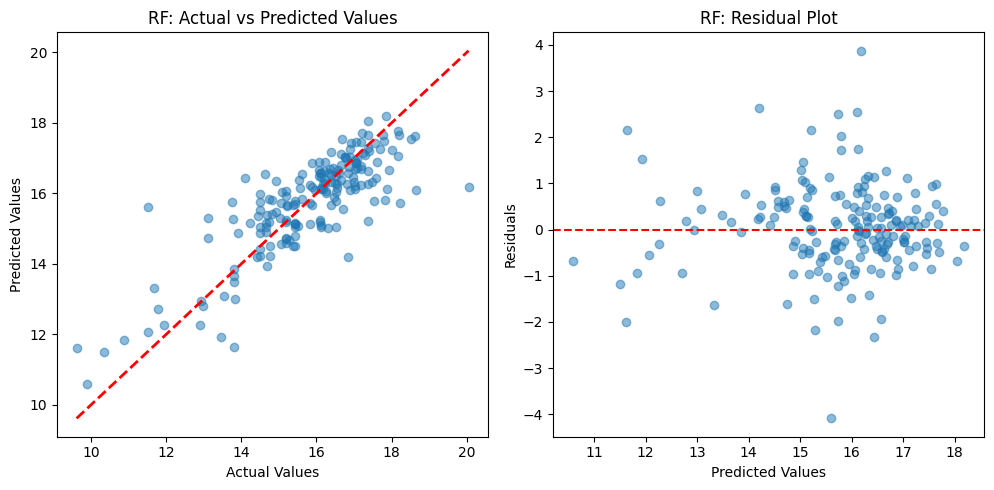

In [ ]:
#Random-Forest
def train_random_forest(X_train, X_test, y_train, y_test, feature_names):
    # Initialize and train model
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(X_train, y_train)

    # Make predictions
    y_pred = rf.predict(X_test)

    # Calculate metrics
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)

    print("Random Forest Performance Metrics:")
    print(f"R² Score: {r2:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE: {mae:.4f}")

    # Visualizations
    plt.figure(figsize=(15, 5))

    # Actual vs Predicted
    plt.subplot(1, 3, 1)
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title('RF: Actual vs Predicted Values')

    # Residuals
    plt.subplot(1, 3, 2)
    residuals = y_test - y_pred
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('RF: Residual Plot')
    plt.axhline(y=0, color='r', linestyle='--')


    plt.tight_layout()
    plt.show()

    return rf, y_pred

# Run Random Forest analysis
X_train_scaled, X_test_scaled, y_train, y_test = prepare_data(df)
rf_model, rf_predictions = train_random_forest(X_train_scaled, X_test_scaled, y_train, y_test, X.columns)

XGBoost Performance Metrics:
R² Score: 0.6207
MSE: 1.0752
RMSE: 1.0369
MAE: 0.7596


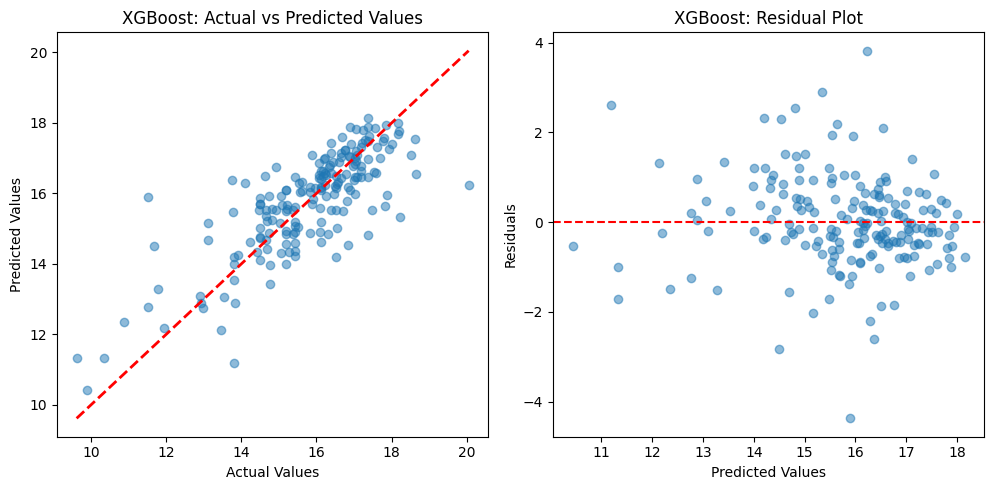

In [ ]:
def train_xgboost(X_train, X_test, y_train, y_test, feature_names):
    # Initialize and train model
    xgb = XGBRegressor(n_estimators=100, random_state=42)
    xgb.fit(X_train, y_train)

    # Make predictions
    y_pred = xgb.predict(X_test)

    # Calculate metrics
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)

    print("XGBoost Performance Metrics:")
    print(f"R² Score: {r2:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE: {mae:.4f}")

    # Visualizations
    plt.figure(figsize=(15, 5))

    # Actual vs Predicted
    plt.subplot(1, 3, 1)
    plt.scatter(y_test, y_pred, alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title('XGBoost: Actual vs Predicted Values')

    # Residuals
    plt.subplot(1, 3, 2)
    residuals = y_test - y_pred
    plt.scatter(y_pred, residuals, alpha=0.5)
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('XGBoost: Residual Plot')
    plt.axhline(y=0, color='r', linestyle='--')


    plt.tight_layout()
    plt.show()

    return xgb, y_pred

# Run XGBoost analysis
X_train_scaled, X_test_scaled, y_train, y_test = prepare_data(df)
xgb_model, xgb_predictions = train_xgboost(X_train_scaled, X_test_scaled, y_train, y_test, X.columns)

In [ ]:
# Lasso Regression
lasso = Lasso(alpha=1.0)  # You can adjust alpha as needed
lasso.fit(X_train_scaled, y_train)
y_pred_lasso = lasso.predict(X_test_scaled)

# Lasso Evaluation Metrics
print("Lasso Regression:")
print(f"Mean Squared Error: {mean_squared_error(y_test, y_pred_lasso):.4f}")
print(f"R2 Score: {r2_score(y_test, y_pred_lasso):.4f}")
print(f"Mean Absolute Error: {mean_absolute_error(y_test, y_pred_lasso):.4f}\n")

Lasso Regression:
Mean Squared Error: 2.7109
R2 Score: 0.0436
Mean Absolute Error: 1.2670



In [ ]:
# Ridge Regression
ridge = Ridge(alpha=1.0)  # You can adjust alpha as needed
ridge.fit(X_train_scaled, y_train)
y_pred_ridge = ridge.predict(X_test_scaled)

# Ridge Evaluation Metrics
print("Ridge Regression:")
print(f"Mean Squared Error: {mean_squared_error(y_test, y_pred_ridge):.4f}")
print(f"R2 Score: {r2_score(y_test, y_pred_ridge):.4f}")
print(f"Mean Absolute Error: {mean_absolute_error(y_test, y_pred_ridge):.4f}\n")

Ridge Regression:
Mean Squared Error: 1.6351
R2 Score: 0.4231
Mean Absolute Error: 0.9202



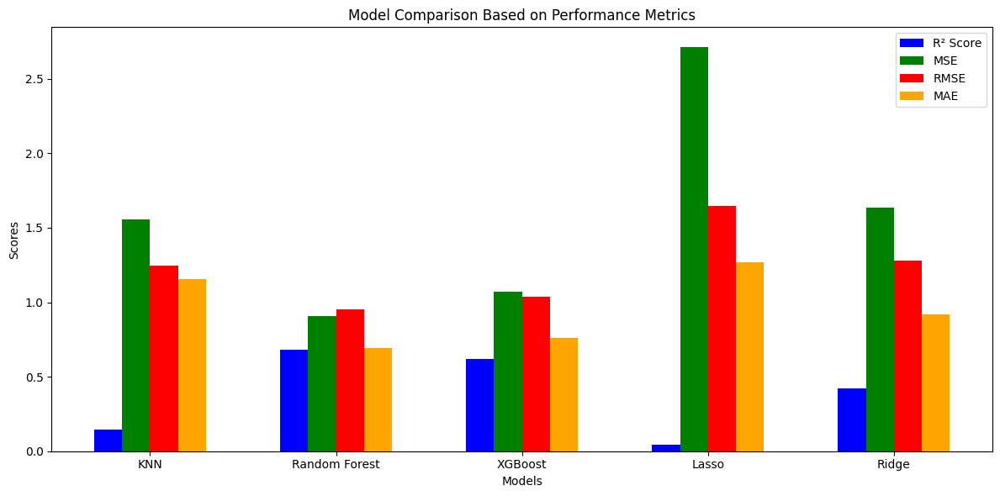

In [ ]:


# Sample data for different models
models = ['KNN', 'Random Forest', 'XGBoost', 'Lasso', 'Ridge']
r2_scores = [ 0.1432, 0.6804, 0.6207, 0.046, 0.4231]  # Example R² scores
mse_values = [ 1.5584, 0.9058, 1.072, 2.7109, 1.6351]  # Example MSE values
rmse_values = [np.sqrt(mse) for mse in mse_values]  # Calculate RMSE
mae_values = [1.1527, 0.6928, 0.7596, 1.2670, 0.9202]  # Example MAE values

# Set bar width and x locations
bar_width = 0.15
x = np.arange(len(models))

# Create subplots
fig, ax = plt.subplots(figsize=(12, 6))

# Plotting the bars
bars1 = ax.bar(x - 1.5 * bar_width, r2_scores, width=bar_width, label='R² Score', color='b')
bars2 = ax.bar(x - 0.5 * bar_width, mse_values, width=bar_width, label='MSE', color='g')
bars3 = ax.bar(x + 0.5 * bar_width, rmse_values, width=bar_width, label='RMSE', color='r')
bars4 = ax.bar(x + 1.5 * bar_width, mae_values, width=bar_width, label='MAE', color='orange')

# Adding labels and title
ax.set_xlabel('Models')
ax.set_ylabel('Scores')
ax.set_title('Model Comparison Based on Performance Metrics')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend()

# Display the plot
plt.tight_layout()
plt.show()
